In [1]:
import matplotlib.pyplot as plt
import numpy as np
import h5py
%matplotlib inline
from IPython.display import Image

import matplotlib
from matplotlib import pyplot as plt
from matplotlib import pylab
%config InlineBackend.figure_format = 'retina'
matplotlib.rcParams['figure.dpi'] = 80
params = {'legend.fontsize': 'large',
          'figure.figsize': (8, 8),
         'axes.labelsize': 'x-large',
         'axes.titlesize': 'x-large',
         'xtick.labelsize': 'large',
         'ytick.labelsize': 'large'}
pylab.rcParams.update(params)

In [2]:
base_dir = '/scratch/ksf293/kavli/anomaly'

In [3]:
NBANDS = 3
NSIDE = 96

#plot_dir = '/home/ksf293/kavli/anomalies-GAN-HSC/plots/plots_2020-07-08'

In [74]:
tag = 'gri'
encnum = 5000
enctag = '_lambda0'

training_dir = '/scratch/ksf293/kavli/anomaly/training_output'

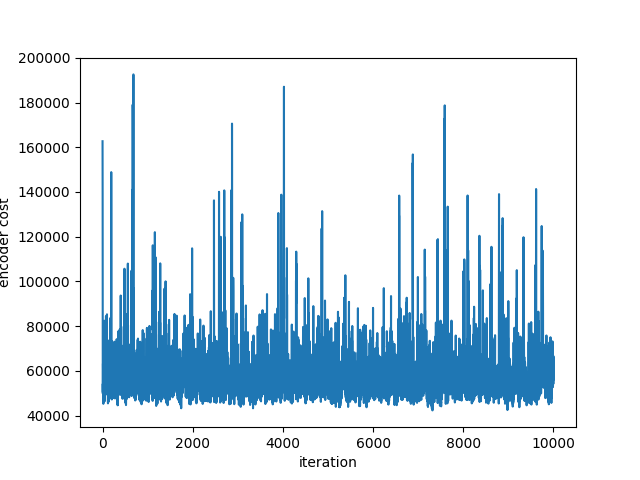

In [75]:
loss_fn = f'{training_dir}/encoder_{tag}{enctag}/encoder_cost.png'
Image(loss_fn)

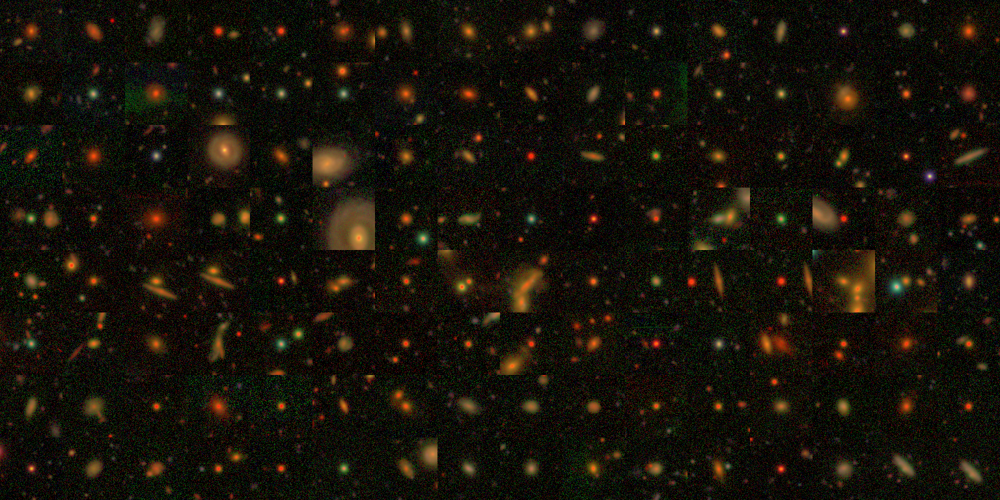

In [36]:
real_fn = f'{training_dir}/encoder_{tag}{enctag}/real.png'
Image(real_fn)

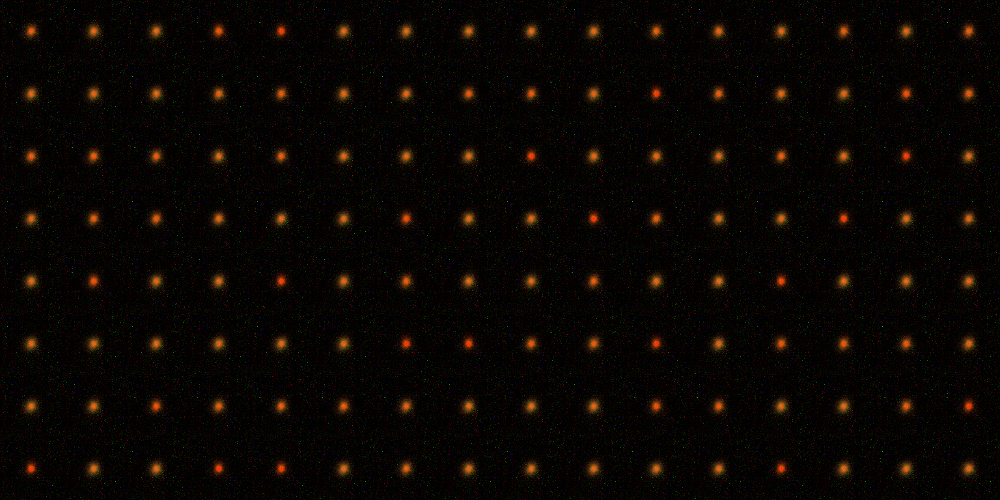

In [40]:
siter = 3000
sample_fn = f'{training_dir}/encoder_{tag}{enctag}/samples_{siter}.png'
Image(sample_fn)

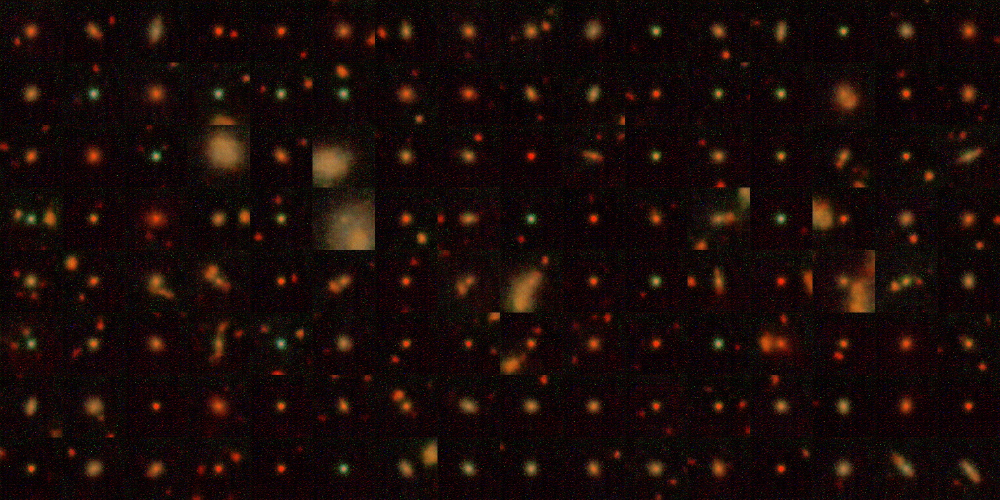

In [24]:
siter = 9000
sample_fn = f'{training_dir}/encoder_{tag}{enctag}/samples_{siter}.png'
Image(sample_fn)

## check out scores of subsample

In [13]:
def plot_anomaly_dist(gens, discs, sanoms=None, lambda_weight=0.5, title=None, 
                      xmin=0, xmax=None, cmin=0, cmax=None, alpha=1):
    
    print(min(gens), max(gens), np.mean(gens), np.std(gens))
    print(min(discs), max(discs), np.mean(discs), np.std(discs))

    if sanoms is None:
        sanoms = (1-lambda_weight)*gens + lambda_weight*discs

    minmin = min(min(gens), min(discs))
    maxmax = max(max(gens), max(discs))
    bins = np.linspace(minmin, maxmax, 200)
    
    fig, axarr = plt.subplots(1, 2, figsize=(12, 6))
    plt.subplots_adjust(wspace=0.35)
    
    fig.suptitle(title, fontsize='xx-large')

    ax0 = axarr[0]
    b = ax0.hist(gens, bins=bins, alpha=1, color='blue', label='generator \nscore', histtype='step')
    b = ax0.hist(discs, bins=bins, alpha=1, color='red', label='discriminator \nscore', histtype='step')
    b = ax0.hist(sanoms, bins=bins, alpha=1, color='purple', label='total \nscore', histtype='step', lw=2)

    ax0.legend()
    ax0.set_xlabel("score")
    ax0.set_ylabel("#")
    
    ax0.set_xlim(xmin,xmax)
    
    ax1 = axarr[1]

    scat = ax1.scatter(gens, discs, s=2, c=sanoms, alpha=alpha, cmap='plasma_r', vmin=cmin, vmax=cmax)
    cbar = fig.colorbar(scat, extend='max', ax=ax1)
    cbar.set_label(r'$s_\mathrm{anom}$, anomaly score', rotation=270, labelpad=18)
    cbar.set_alpha(1)
    cbar.draw_all()
    
    #xx = np.linspace(0,maxmax,100)
    #ax1.plot(xx, xx, color='k', lw=0.5)

    ax1.set_xlabel(r"$s_\mathrm{gen}$, generator score")
    ax1.set_ylabel(r"$s_\mathrm{disc}$, discriminator score")

    #ax1.set_xlim(0, maxmax)
    #ax1.set_ylim(0, maxmax)

In [5]:
tag = 'gri'
imdict_fn = f'{base_dir}/data/idxdicts_h5/idx2imloc_{tag}.npy'
resdict_fn = f'{base_dir}/data/idxdicts_h5/idx2resloc_{tag}.npy'
idx2imloc = np.load(imdict_fn, allow_pickle=True).item()
idx2resloc = np.load(resdict_fn, allow_pickle=True).item()

In [6]:
def get_residual(im, recon):
    im = np.array(im)
    reals = im.reshape((96,96,-1))
    #reals = luptonize(reals).astype('int')
    recon = np.array(recon)
    recon = recon.reshape((96,96,-1)).astype('int')
    resid = abs(im-recon)
    return resid

In [7]:
from astropy.visualization import make_lupton_rgb
def luptonize(x, rgb_q=15, rgb_stretch=0.5, rgb_min=0):
    if x.ndim==3:
        x = make_lupton_rgb(x[:,:,2], x[:,:,1], x[:,:,0],
                      Q=rgb_q, stretch=rgb_stretch, minimum=rgb_min)
    elif x.ndim==4:
        x = np.array([make_lupton_rgb(xi[:,:,2], xi[:,:,1], xi[:,:,0],
                      Q=rgb_q, stretch=rgb_stretch, minimum=rgb_min)
                      for xi in x])
    else:
        raise ValueError(f"Wrong number of dimensions! Gave {x.ndim}, need 3 or 4")
    return x

In [8]:
def plot_recons(ids, saveto=None, border_color=None, subsize=2.0, scores=None):
    nims = len(ids)
    fig, axarr = plt.subplots(3,nims,figsize=(nims*subsize,3*subsize), edgecolor=border_color)
    plt.subplots_adjust(hspace=0.02, wspace=0.1)
    count = 0
    for i in range(nims):
        idx = ids[i]
        
        loc = idx2imloc[idx]
        im = luptonize(imarr['images'][loc])
        
        rloc = idx2resloc[idx]
        recon = res['reconstructed'][rloc]
        if scores is None:
            score = float(res['anomaly_scores'][rloc])
        else:
            score = scores[i]
        obj_id = res['object_ids'][rloc]
        resid = get_residual(im, recon)
        
        ax0 = axarr[0][i]
        ax1 = axarr[1][i]
        ax2 = axarr[2][i]
#         title = r'''ID: {}
# $s_\mathrm{{anom}}$ = {:.4f}'''.format(obj_id, score)
        title = r'''ID: {}
$s_\mathrm{{g}}$ = {:.1f}, $s_\mathrm{{d}}$ = {:.1f}'''.format(obj_id, score[0], score[1])
        ax0.set_title(title, fontsize=8)
        ax0.imshow(im)
        ax1.imshow(recon)
        ax2.imshow(resid)
        
        if i==0:
            fsize=13
            ax0.set_ylabel("real",fontsize=fsize)
            ax1.set_ylabel("reconstructed",fontsize=fsize)
            ax2.set_ylabel("residual",fontsize=fsize)
        
        for ax in [ax0, ax1, ax2]:
            ax.set_xticks([])
            ax.set_yticks([])
    
    if border_color is not None:
        fig.patch.set_edgecolor(border_color)  
        fig.patch.set_linewidth('4') 
        
    if saveto:
        plt.savefig(saveto, bbox_inches='tight', edgecolor=border_color)#, pad_inches=0)

In [10]:
lambda_weight = 0.0
tag = f'gri_10k_lambda{lambda_weight}'
base_dir = '/scratch/ksf293/kavli/anomaly'
results_dir = f'{base_dir}/results'
results_fn_10k = f'{results_dir}/results_{tag}.h5'
res_10k = h5py.File(results_fn_10k)

In [11]:
gen_scores = res_10k['gen_scores'][:]
disc_scores = res_10k['disc_scores'][:]
scores = res_10k['anomaly_scores'][:]
idxs = res_10k['idxs'][:]

647.44196 6805.3643 1564.1533 464.07867
2421.5732 23155.77 4420.455 1267.5308


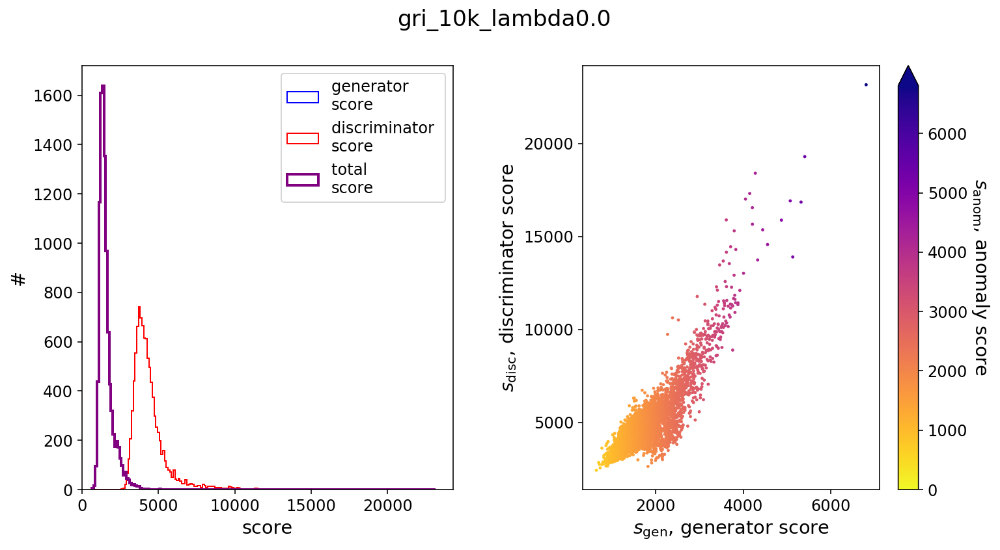

In [14]:
plot_anomaly_dist(gen_scores, disc_scores, lambda_weight=lambda_weight, title=tag)

In [82]:
def print_stats(arr):
    print(np.mean(arr), np.median(arr), np.std(arr))

In [83]:
print_stats(scores)
print_stats(gen_scores)
print_stats(disc_scores)

1564.1533 1442.0603 464.07867
1564.1533 1442.0603 464.07867
4420.455 4132.9736 1267.5308


In [84]:
lamb = np.median(gen_scores)/(np.median(gen_scores) + np.median(disc_scores))
lamb

0.25866395

### check out top scorers

In [85]:
tag = 'gri'
base_dir = '/scratch/ksf293/kavli/anomaly'
imarr_fn = f'{base_dir}/data/images_h5/images_{tag}.h5'
imarr = h5py.File(imarr_fn, 'r')
results_fn = f'{base_dir}/results/results_{tag}.h5'
res = h5py.File(results_fn, 'r')

In [86]:
n_top = 8
locs_top = scores.argsort()[-n_top:][::-1]
idxs_top = idxs[locs_top]

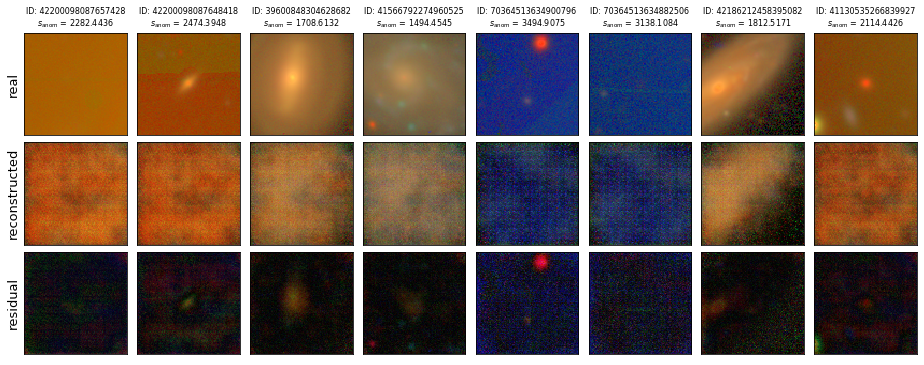

In [89]:
plot_recons(idxs_top)

lambda = 0.0
lambda = 0.1
lambda = 0.3
lambda = 0.5
lambda = 0.7
lambda = 0.9
lambda = 1.0


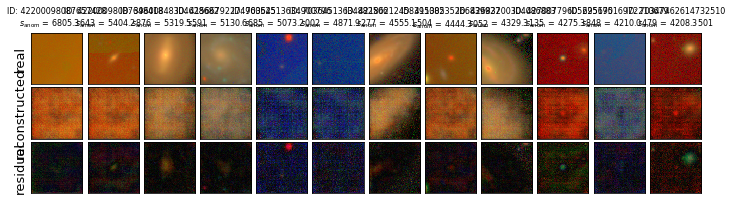

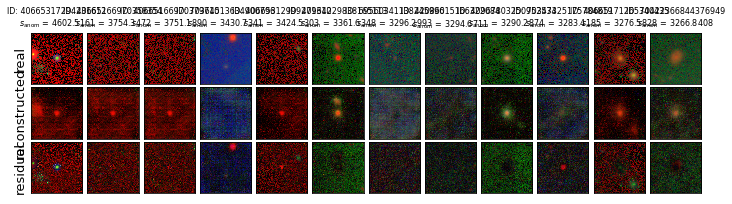

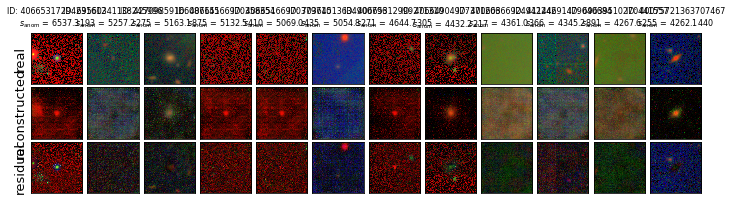

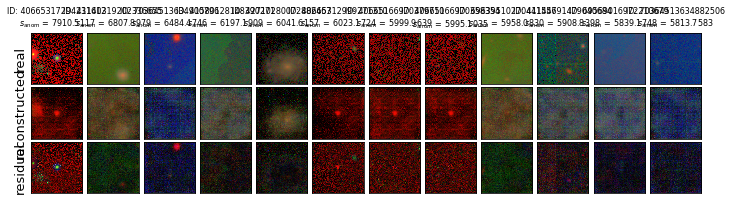

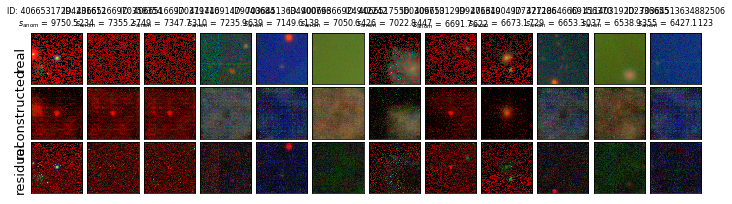

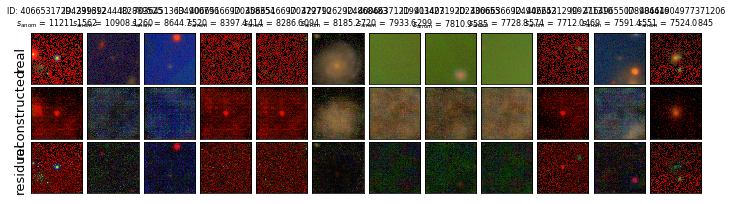

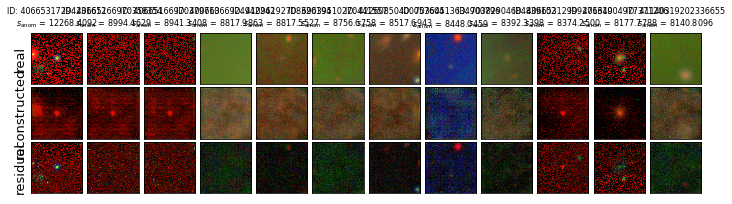

In [98]:
lambda_weights = [0.0, 0.1, 0.3, 0.5, 0.7, 0.9, 1.0]
n_top = 12

for lambda_weight in lambda_weights:
    
    print('lambda =', lambda_weight)
    tag = f'gri_10k_lambda{lambda_weight}'
    base_dir = '/scratch/ksf293/kavli/anomaly'
    results_dir = f'{base_dir}/results'
    results_fn_10k = f'{results_dir}/results_{tag}.h5'
    res_10k = h5py.File(results_fn_10k)
    
    scores = res_10k['anomaly_scores'][:]
    idxs = res_10k['idxs'][:]
    locs_top = scores.argsort()[-n_top:][::-1]
    idxs_top = idxs[locs_top]
    scores_top = scores[locs_top]
    
    plot_recons(idxs_top, subsize=1.0, scores=scores_top)

lambda = 0.0
lambda = 0.1
lambda = 0.3
lambda = 0.5
lambda = 0.7
lambda = 0.9
lambda = 1.0


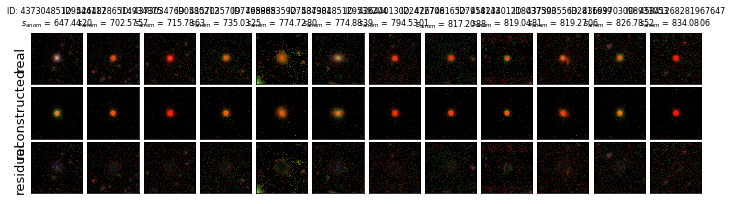

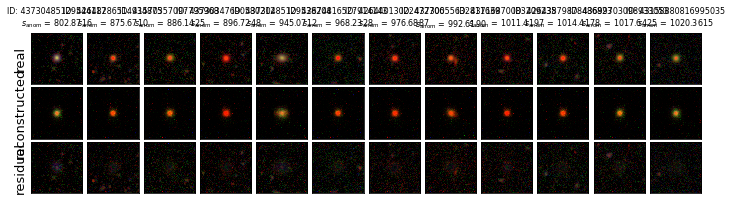

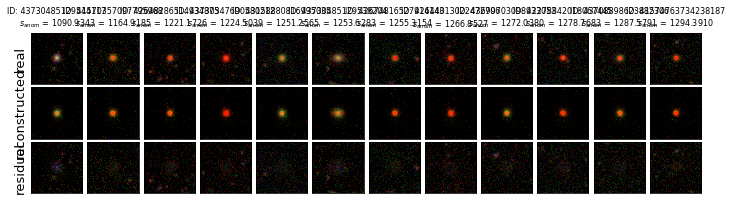

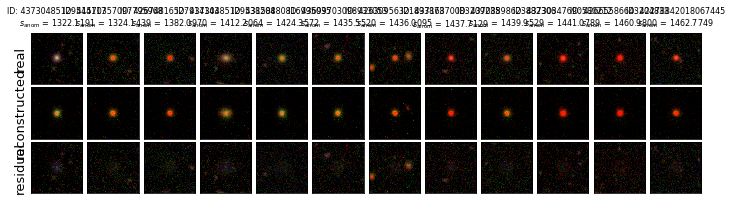

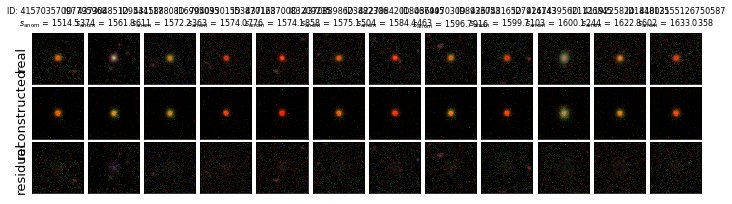

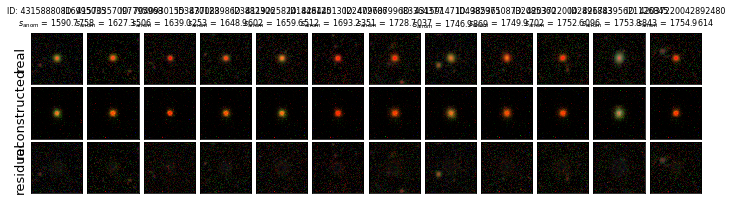

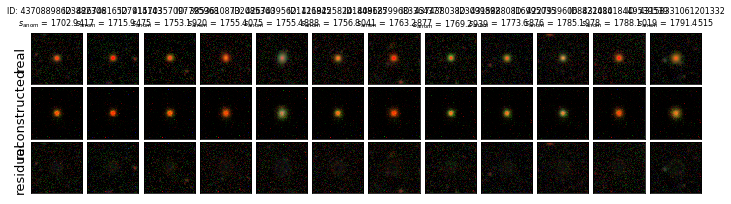

In [100]:
lambda_weights = [0.0, 0.1, 0.3, 0.5, 0.7, 0.9, 1.0]
n_bot = 12

for lambda_weight in lambda_weights:
    
    print('lambda =', lambda_weight)
    tag = f'gri_10k_lambda{lambda_weight}'
    base_dir = '/scratch/ksf293/kavli/anomaly'
    results_dir = f'{base_dir}/results'
    results_fn_10k = f'{results_dir}/results_{tag}.h5'
    res_10k = h5py.File(results_fn_10k)
    
    scores = res_10k['anomaly_scores'][:]
    idxs = res_10k['idxs'][:]
    locs_bot = scores.argsort()[:n_bot]
    idxs_bot = idxs[locs_bot]
    scores_bot = scores[locs_bot]

    plot_recons(idxs_bot, subsize=1.0, scores=scores_bot)

lambda = 0.0
lambda = 0.1
lambda = 0.3
lambda = 0.5
lambda = 0.7
lambda = 0.9
lambda = 1.0


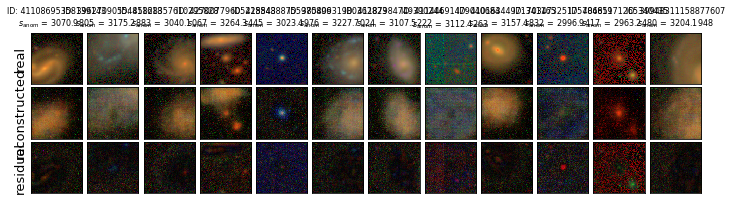

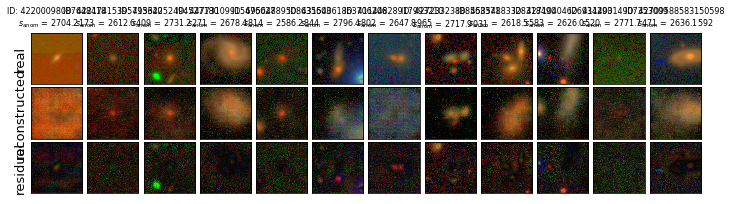

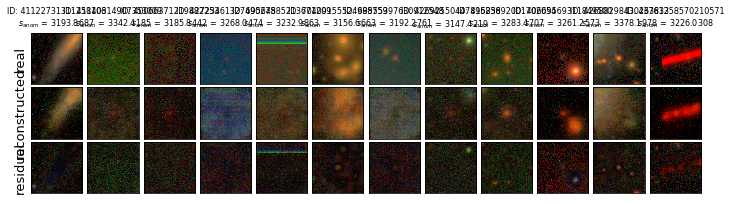

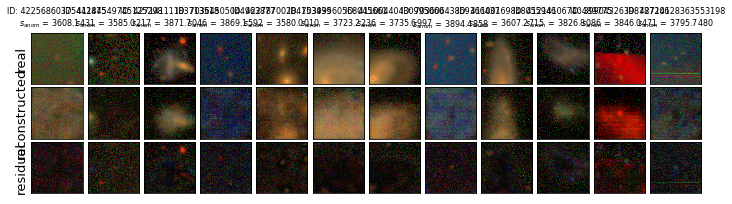

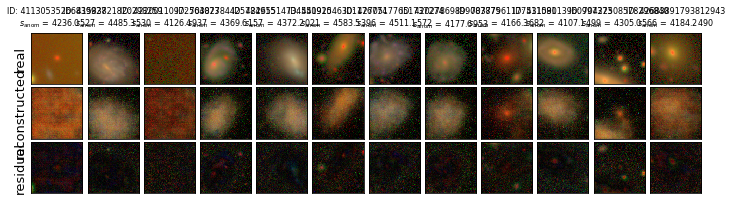

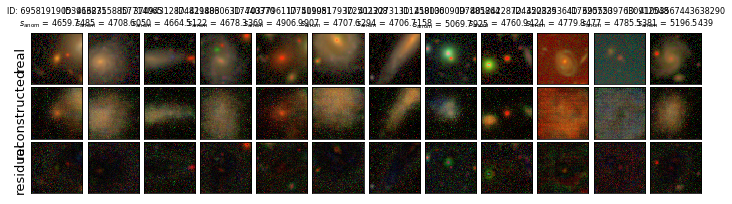

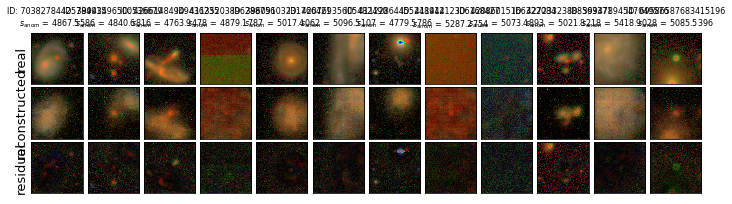

In [105]:
lambda_weights = [0.0, 0.1, 0.3, 0.5, 0.7, 0.9, 1.0]
n_3sig = 12

for lambda_weight in lambda_weights:
    
    print('lambda =', lambda_weight)
    tag = f'gri_10k_lambda{lambda_weight}'
    base_dir = '/scratch/ksf293/kavli/anomaly'
    results_dir = f'{base_dir}/results'
    results_fn_10k = f'{results_dir}/results_{tag}.h5'
    res_10k = h5py.File(results_fn_10k)
    
    scores = res_10k['anomaly_scores'][:]
    idxs = res_10k['idxs'][:]
    
    smean = np.mean(scores)
    sstd = np.std(scores)
    thresh_lower = smean + 3*sstd
    thresh_upper = smean + 4*sstd

    locs_3sig_all = np.where((scores>thresh_lower) & (scores<thresh_upper))[0]
    locs_3sig = np.random.choice(locs_3sig_all, size=n_3sig, replace=False)
    idxs_3sig = idxs[locs_3sig]
    scores_3sig = scores[locs_3sig]
    

    plot_recons(idxs_3sig, subsize=1.0, scores=scores_3sig)

# trying to put all this together (2021-01-10)

anomaly_score = (1-lambda_weight)\*residual + lambda_weight\*feature_residual

high lambda_weight: pref discriminator.

low lambda_weight: pref generator.

mean of disc ~3x higher than mean of gen. so to balance, choose lambda_weight = 0.3

In [15]:
imtag = 'gri'
tag = 'gri_lambda0.3'
base_dir = '/scratch/ksf293/kavli/anomaly'
imarr_fn = f'{base_dir}/data/images_h5/images_{imtag}.h5'
imarr = h5py.File(imarr_fn, 'r')
results_fn = f'{base_dir}/results/results_{tag}.h5'
res = h5py.File(results_fn, 'r')

In [16]:
print(imarr.keys())
print(res.keys())

<KeysViewHDF5 ['idxs', 'images', 'object_ids']>
<KeysViewHDF5 ['anomaly_scores', 'anomaly_scores_sigma', 'disc_scores', 'disc_scores_sigma', 'gen_scores', 'gen_scores_sigma', 'idxs', 'object_ids', 'reconstructed']>


In [17]:
def plot_ims(ids, nrows, ncols, saveto=None, headers=None, tight=False):
    assert len(ids)<=nrows*ncols, "bad rows/cols for number of ids!"
    
    subsize = 2
    fig, axarr = plt.subplots(nrows,ncols,figsize=(ncols*subsize,nrows*subsize))
    if tight:
        plt.subplots_adjust(hspace=0, wspace=-0.13)
    else:
        plt.subplots_adjust(hspace=0.2, wspace=0.05)
    plt.rc('text', usetex=True)
    
    count = 0
    for i in range(nrows):
        for j in range(ncols):
            idx = ids[count]
            loc = idx2imloc[idx]
            im = imarr['images'][loc]
            obj_id = int(imarr['object_ids'][loc])
            if nrows==1 and ncols==1:
                ax = axarr
            elif nrows==1:
                ax = axarr[j]
            elif ncols==1:
                ax = axarr[i]
            else:
                ax = axarr[i][j]
                
            if not tight:
                title = f"ID: {obj_id}"
                ax.set_title(title, fontsize=8)
            
            ax.imshow(luptonize(im))
            ax.set_xticks([])
            ax.set_yticks([])
            
            if headers is not None and i==0:
                # units are pixel values;
                nside = 96
                ax.text(nside/2,-nside/4,headers[j], size=16, horizontalalignment='center')
                
            count += 1
            if count>=len(ids):
                break
                
        if count>=len(ids):
            break
                
    if saveto:
        plt.savefig(saveto, bbox_inches='tight')#, pad_inches=0)

10k because we just did the anomaly detection for a 10k subsample for now

In [18]:
# lambda_weight = 0.3
# #tag = f'gri_10k_lambda{lambda_weight}'
# base_dir = '/scratch/ksf293/kavli/anomaly'
# results_dir = f'{base_dir}/results'
# results_fn_10k = f'{results_dir}/results_{tag}.h5'
# print(results_fn_10k)
# res_10k = h5py.File(results_fn_10k)

In [20]:
print('loading')
gen_scores = res['gen_scores'][:]
print(len(gen_scores))
disc_scores = res['disc_scores'][:]
scores = res['anomaly_scores'][:]
idxs = res['idxs'][:]

loading
942781


In [21]:
gen_scores_sigma = res['gen_scores_sigma'][:]
disc_scores_sigma = res['disc_scores_sigma'][:]
scores_sigma = res['anomaly_scores_sigma'][:]

299.97336 8492.496 1570.7557 271.53238
1465.9086 27671.162 3067.824 699.4436


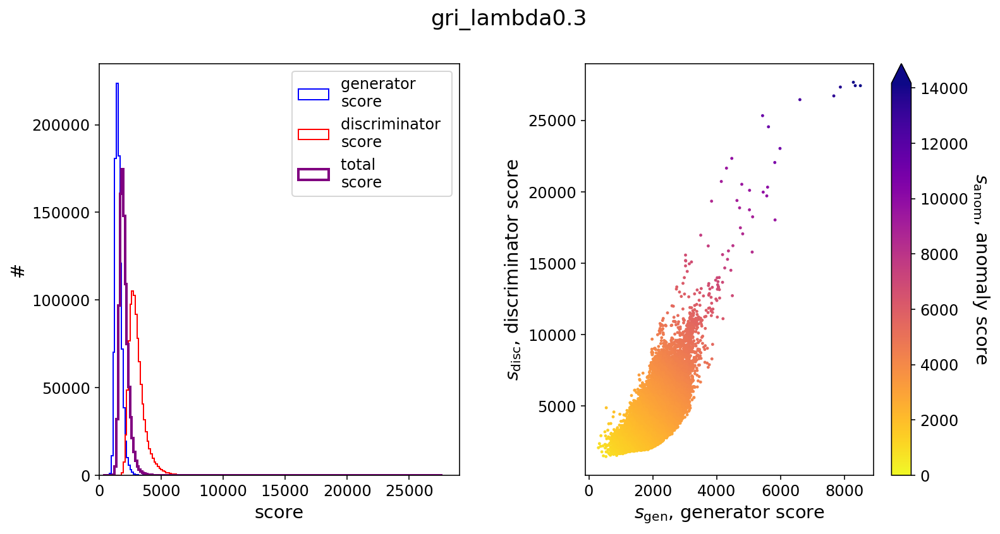

In [22]:
plot_anomaly_dist(gen_scores, disc_scores, sanoms=scores, title=tag)

-4.68004 25.4914 -1.0076863e-06 1.0
-2.290271 35.175587 1.5472738e-08 0.9999999


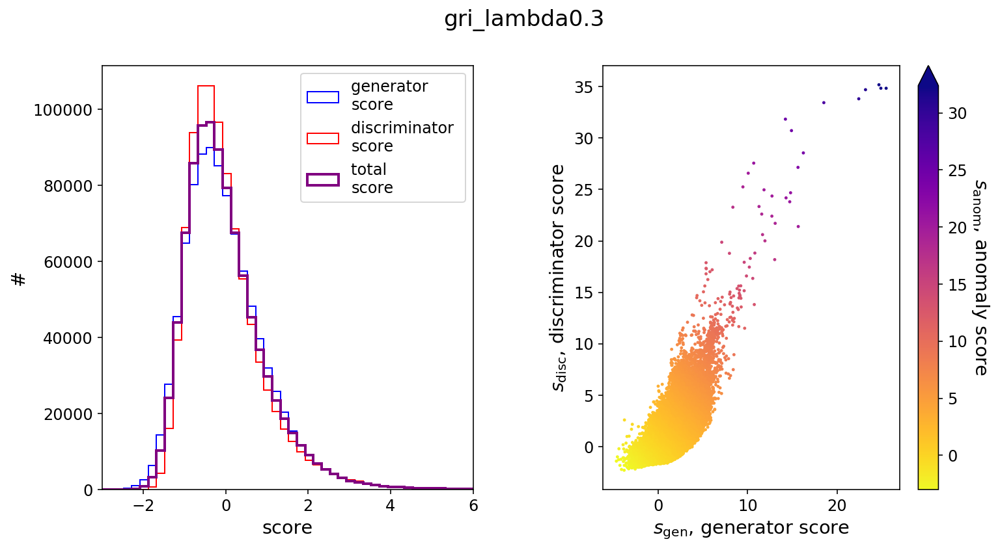

In [26]:
plot_anomaly_dist(gen_scores_sigma, disc_scores_sigma, sanoms=scores_sigma, title=tag,
                  xmin=-3, xmax=6, cmin=-3, cmax=None)

In [19]:
def print_stats(arr):
    print('Mean:', np.mean(arr), 'Median:', np.median(arr), 'stdev:', np.std(arr), 'len:', len(arr))
    print('Min:', min(arr), 'Max:', max(arr))

In [20]:
print_stats(scores)
print_stats(gen_scores)
print_stats(disc_scores)

Mean: 2019.8763 Median: 1951.9773 stdev: 375.3995 len: 942781
Min: 774.7909 Max: 14174.692
Mean: 1570.7557 Median: 1527.8364 stdev: 271.53238 len: 942781
Min: 299.97336 Max: 8492.496
Mean: 3067.824 Median: 2925.7747 stdev: 699.4436 len: 942781
Min: 1465.9086 Max: 27671.162


In [15]:
thresh_gen3sig = np.mean(gen_scores) + 3*np.std(gen_scores)
gen_3sig = np.where(gen_scores>thresh_gen3sig)[0]

thresh_disc3sig = np.mean(disc_scores) + 3*np.std(disc_scores)
disc_3sig = np.where(disc_scores>thresh_disc3sig)[0]

In [21]:
gen_sigma = (gen_scores - np.mean(gen_scores))/np.std(gen_scores)
disc_sigma = (disc_scores - np.mean(disc_scores))/np.std(disc_scores)
sanom_sigma = (scores - np.mean(scores))/np.std(scores)

In [22]:
print_stats(gen_sigma)
print_stats(disc_sigma)
print_stats(sanom_sigma)

Mean: -1.0076863e-06 Median: -0.15806332 stdev: 1.0 len: 942781
Min: -4.68004 Max: 25.4914
Mean: 1.5472738e-08 Median: -0.20308901 stdev: 0.9999999 len: 942781
Min: -2.290271 Max: 35.175587
Mean: -8.110239e-07 Median: -0.18087144 stdev: 1.0 len: 942781
Min: -3.3166945 Max: 32.37835


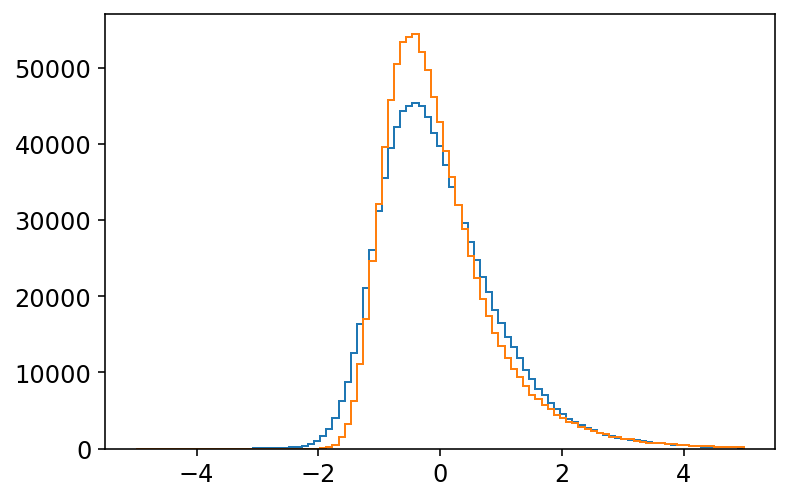

In [23]:
bins = np.linspace(-5, 5, 100)
b = plt.hist(gen_sigma, bins=bins, histtype='step')
b = plt.hist(disc_sigma, bins=bins, histtype='step')

In [24]:
#gdratio = gen_sigma/disc_sigma
gd_diff = gen_sigma - disc_sigma
print(min(gd_diff), max(gd_diff))
#ratio_bins = np.array([0.4,0.6,0.7,0.9,1.1,1.3,1.4,1.6])
#am = np.argmax(gdratio)
#print(gen_sigma[am], disc_sigma[am])

diff_bins = np.array([-2.5, -1.5, -0.5, 0.5, 1.5, 2.5])
diff_locs_binned = []
for i in range(len(diff_bins)-1):
    locs_inbin = np.where(((gen_sigma > 3) | (disc_sigma > 3)) & 
                          (diff_bins[i] < gd_diff) & 
                          (gd_diff <= diff_bins[i+1]))[0]
    diff_locs_binned.append(locs_inbin)
diff_bin_means = 0.5*(diff_bins[:-1]+diff_bins[1:])
print([round(d,2) for d in diff_bin_means])
print(diff_bin_means)

-17.606411 3.8168943
[-2.0, -1.0, 0.0, 1.0, 2.0]
[-2. -1.  0.  1.  2.]


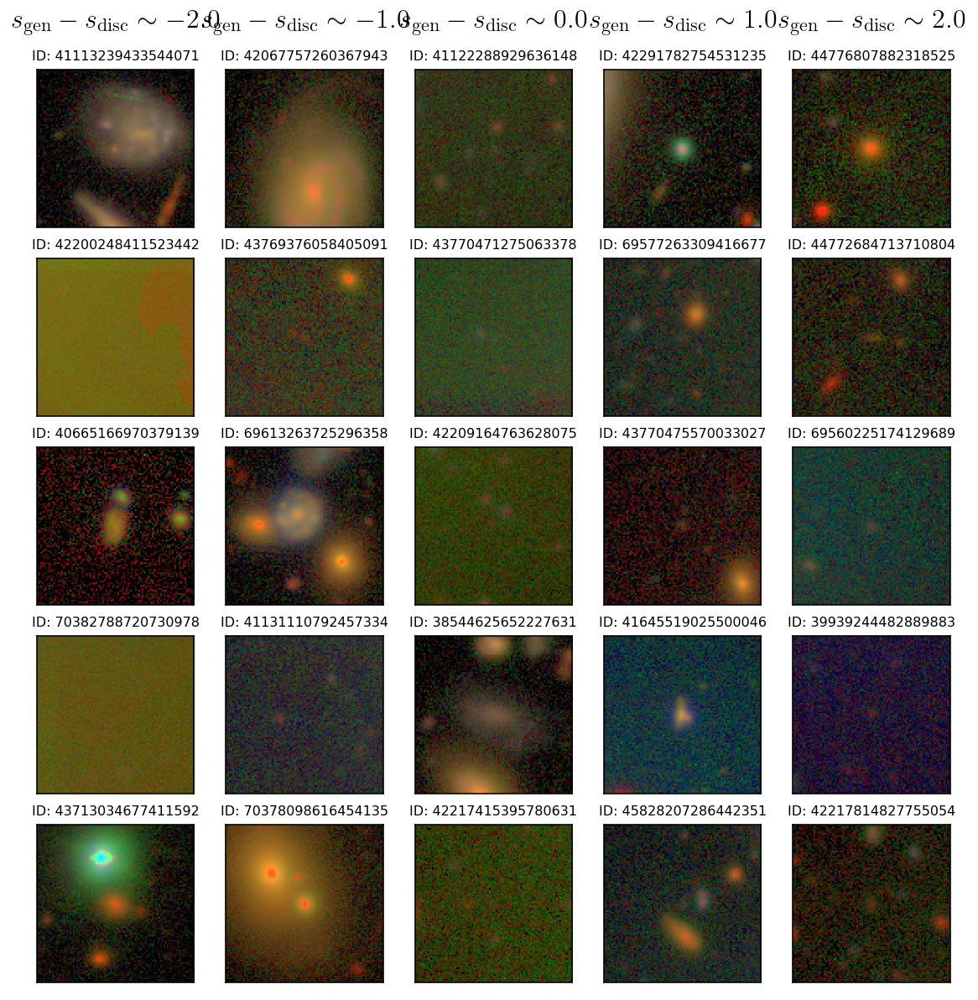

In [25]:
seed = 37 #41, 37
np.random.seed(seed)
ncols = 5
nrows = len(diff_bins)-1
diff_sample_idxs = np.empty((nrows, ncols))
headers = []
#headers = [r'$\frac{s_\mathrm{gen}}{s_\mathrm{disc}}\sim'+str(round(d,2))+'$' for d in diff_bin_means]
headers = [r'$s_\mathrm{gen} - s_\mathrm{disc} \sim'+str(round(d,2))+'$' for d in diff_bin_means]
for i in range(len(diff_bins)-1):
    diff_sample_idxs[i] = np.random.choice(idxs[diff_locs_binned[i]], ncols, replace=False)
plot_ims(diff_sample_idxs.T.flatten(), ncols, nrows, headers=headers)

In [26]:
locs_lo = np.where(((gen_sigma < 0) & (disc_sigma < 0)))[0]
locs_hi = np.where(((gen_sigma > 3) & (disc_sigma > 3)))[0]
locs_mid = np.where(((gen_sigma > 1) & (gen_sigma < 2) & (disc_sigma > 1) & (disc_sigma < 2)))[0]
locs_genhi = np.where(((gen_sigma > 3) & (3 > disc_sigma)))[0]
locs_dischi = np.where(((disc_sigma > 3) & (3 > gen_sigma)))[0]

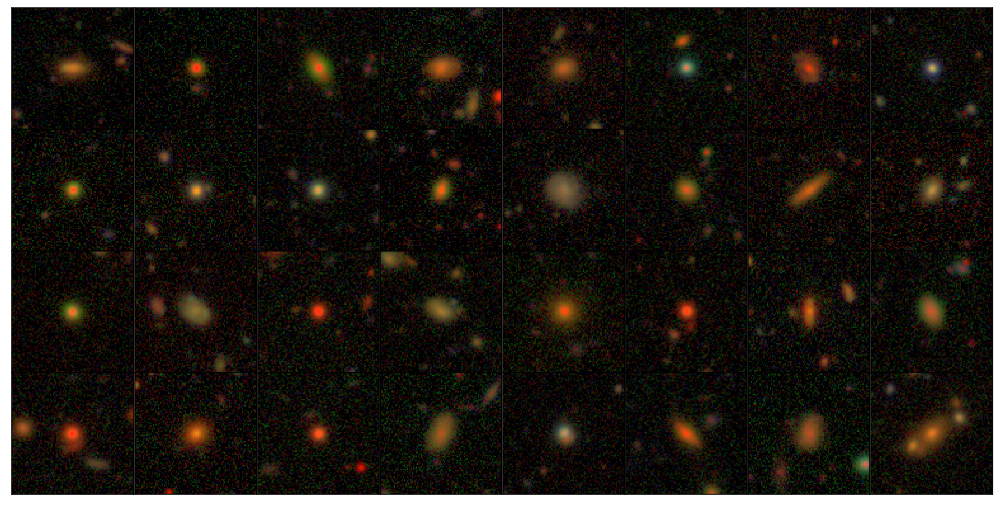

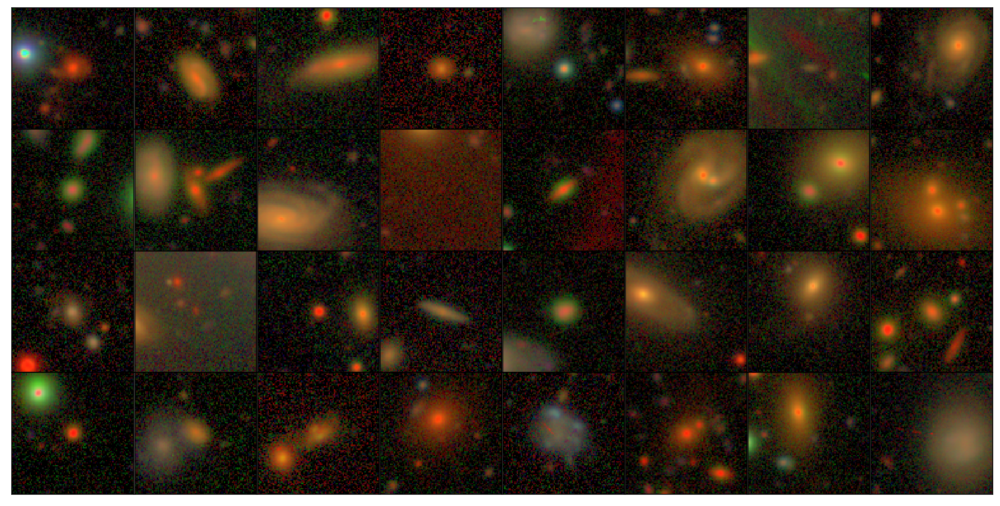

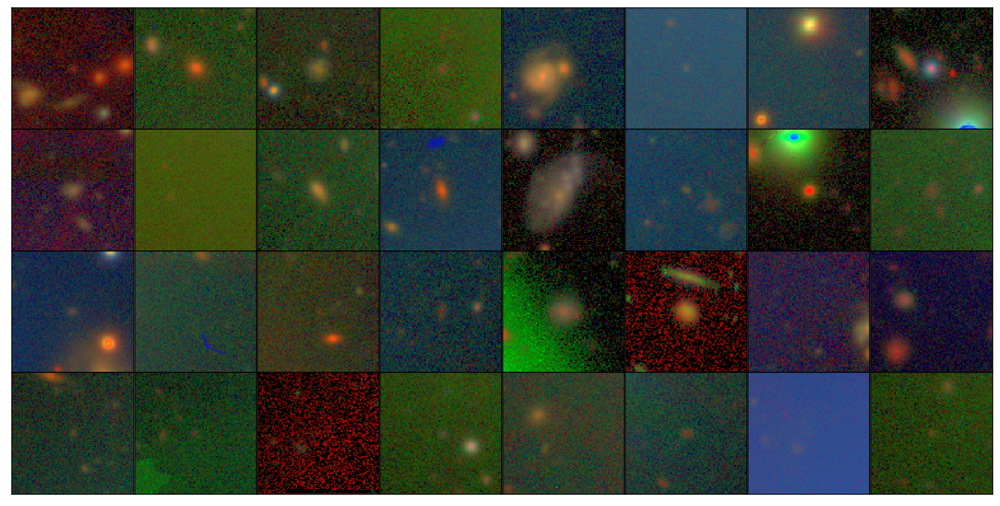

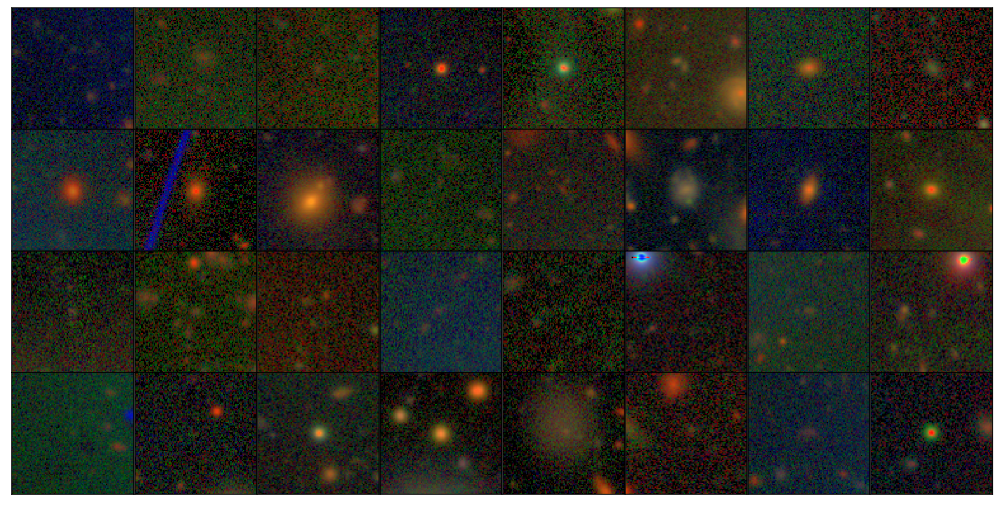

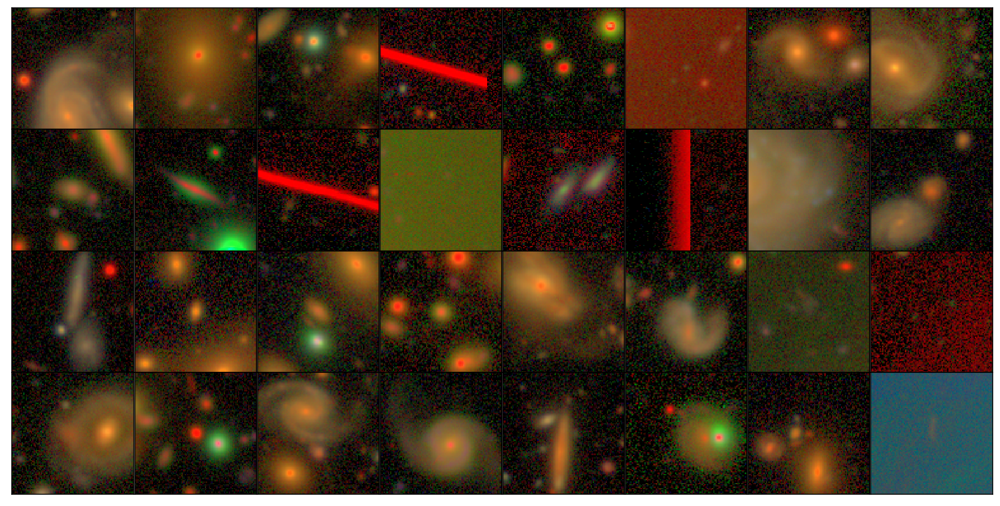

In [27]:
n_plot = 32
for locs in [locs_lo, locs_mid, locs_hi, locs_genhi, locs_dischi]:
    scores_sub = [(gen_sigma[loc], disc_sigma[loc]) for loc in locs]
    idxs_sub = [idxs[loc] for loc in locs]
    idxs_sub = np.random.choice(idxs_sub, n_plot, replace=False)
    plot_ims(idxs_sub, 4, 8, tight=True)
    #plot_recons(idxs_sub, scores=scores_sub)

In [28]:
len(locs_dischi)

8608

In [ ]:
imtag = 'gri'
tag = 'gri_lambda0.3'
base_dir = '/scratch/ksf293/kavli/anomaly'
results_fn = f'{base_dir}/results/results_{tag}.h5'
res = h5py.File(results_fn, 'r')

In [ ]:
print("oof")